In [2]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import gridspec
import warnings
warnings.filterwarnings('ignore')

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
# sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80, facecolor='white')

In [4]:
batch_corrected_umap = sc.read('/scratch/batch_corrected_umap.h5ad')

# UMAP Visualization by Batches

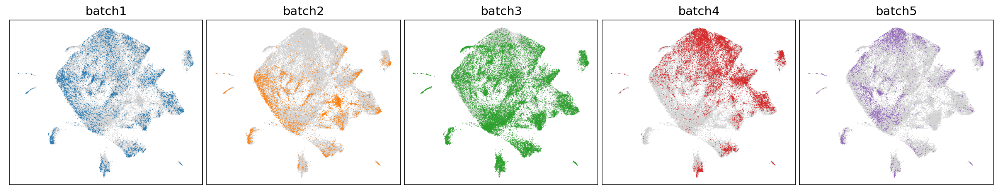

In [5]:
n_batch = len(set(batch_corrected_umap.obs['bat']))
batch = ['batch'+str(i) for i in range(1,n_batch+1)]
fig, ax = plt.subplots(1, n_batch,sharex=True,gridspec_kw={'width_ratios': [1]*n_batch}, figsize=(16,3))

for i in range(n_batch):
    sc.pl.umap(batch_corrected_umap, color='bat', groups=batch[i],ax=ax[i],show=False)
    ax[i].get_legend().remove()
    ax[i].set_title(batch[i])
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
plt.tight_layout(pad=0.1)
plt.show()

# UMAP Visualization of all samples together

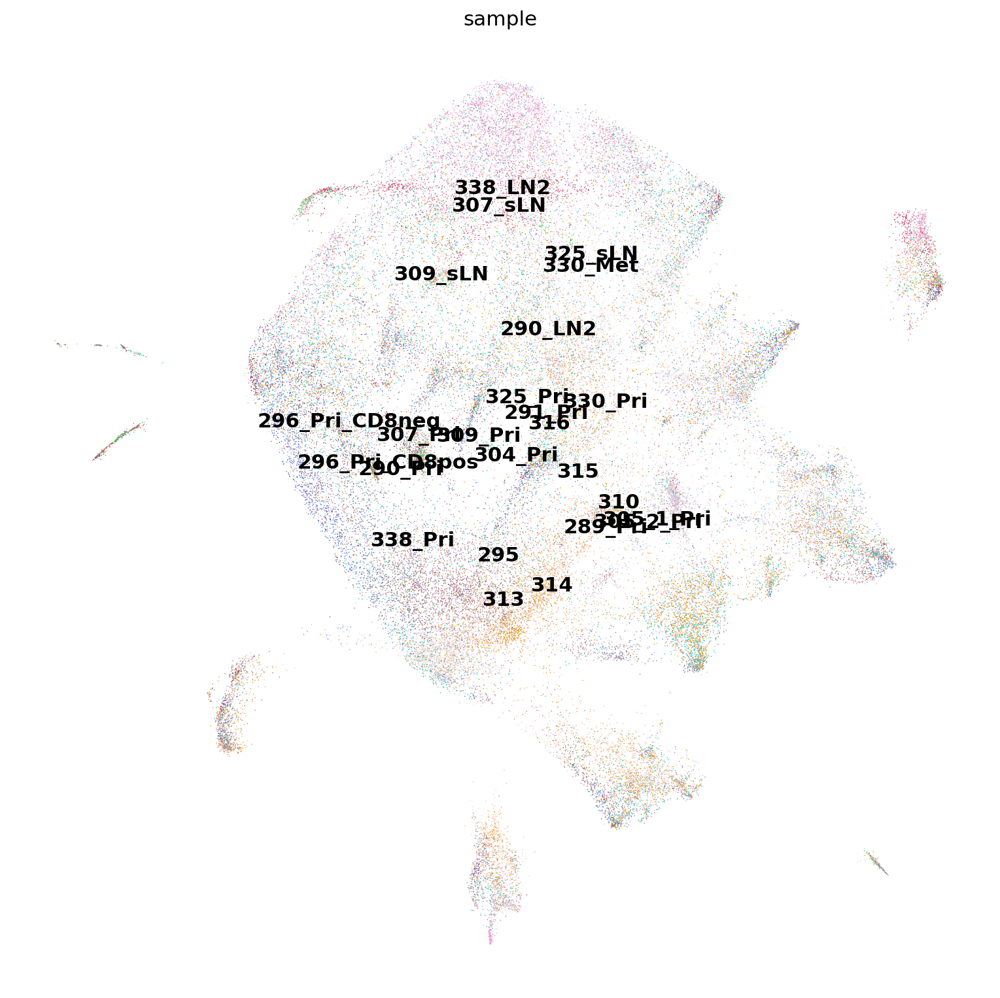

In [6]:
fig, ax = plt.subplots(figsize=(12,12))
sc.pl.umap(batch_corrected_umap, color='sample',legend_loc='on data',frameon=False,ax=ax)
ax.set_title("All Samples")
plt.show()

# UMAP Visualization by Samples

In [7]:
dataset_names =['289_Pri','290_Pri','295','296_Pri_CD8pos','305_1_Pri','307_Pri','309_Pri','310','314',
                '316','290_LN2','291_Pri','296_Pri_CD8neg','304_Pri','305_2_Pri','307_sLN','309_sLN',
                '313','315','325_Pri','325_sLN','330_Pri','330_Met']

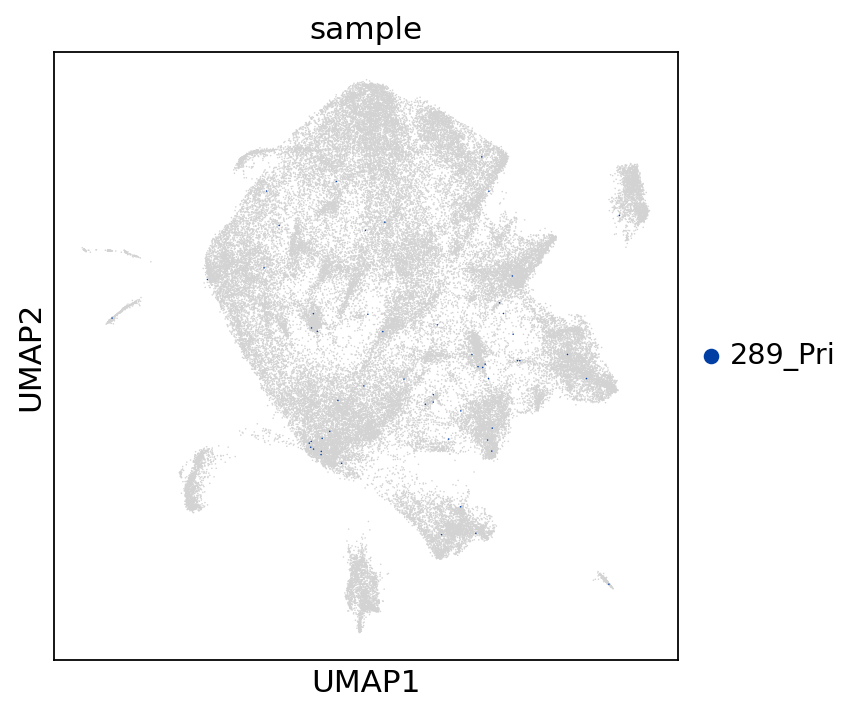

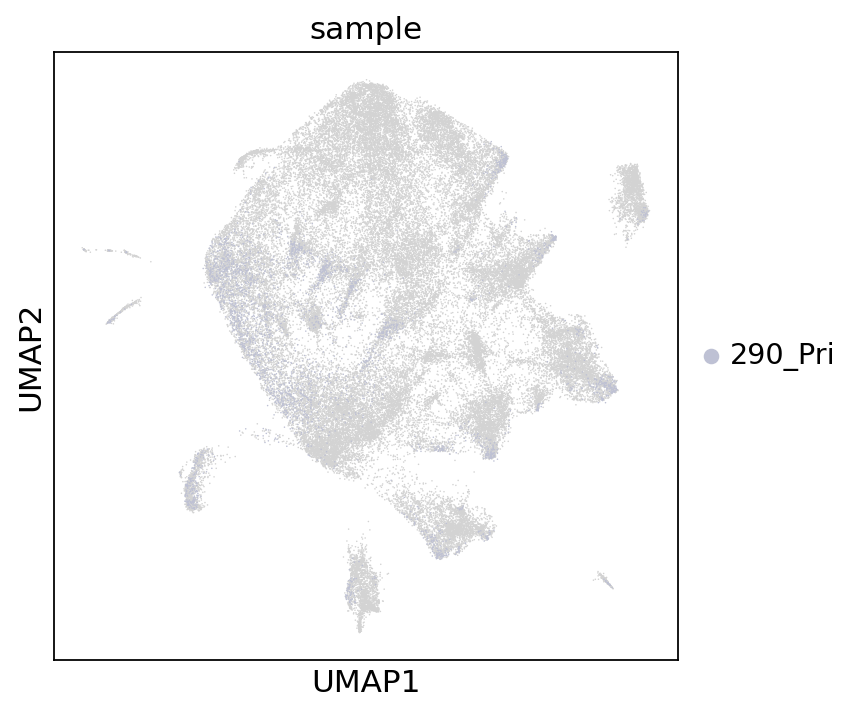

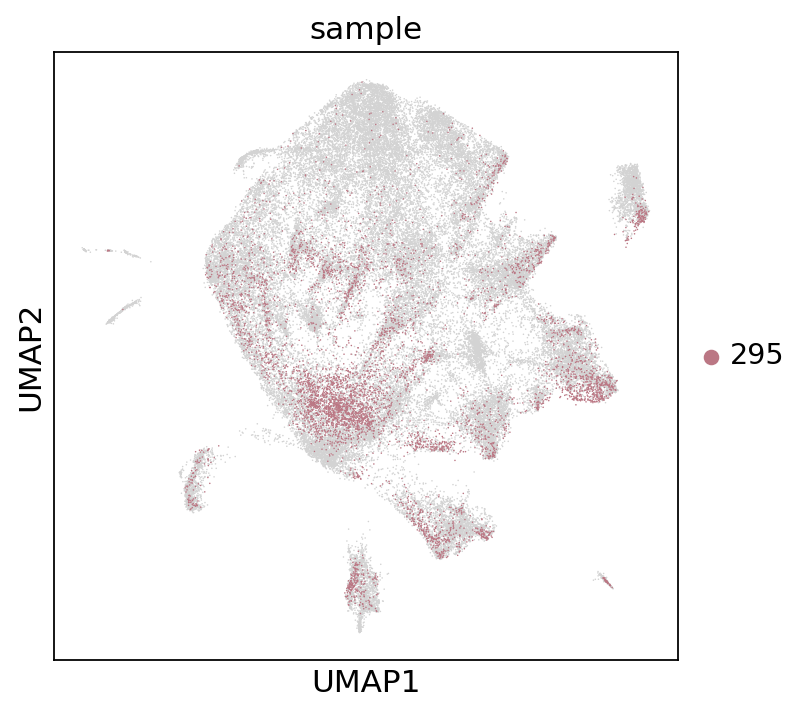

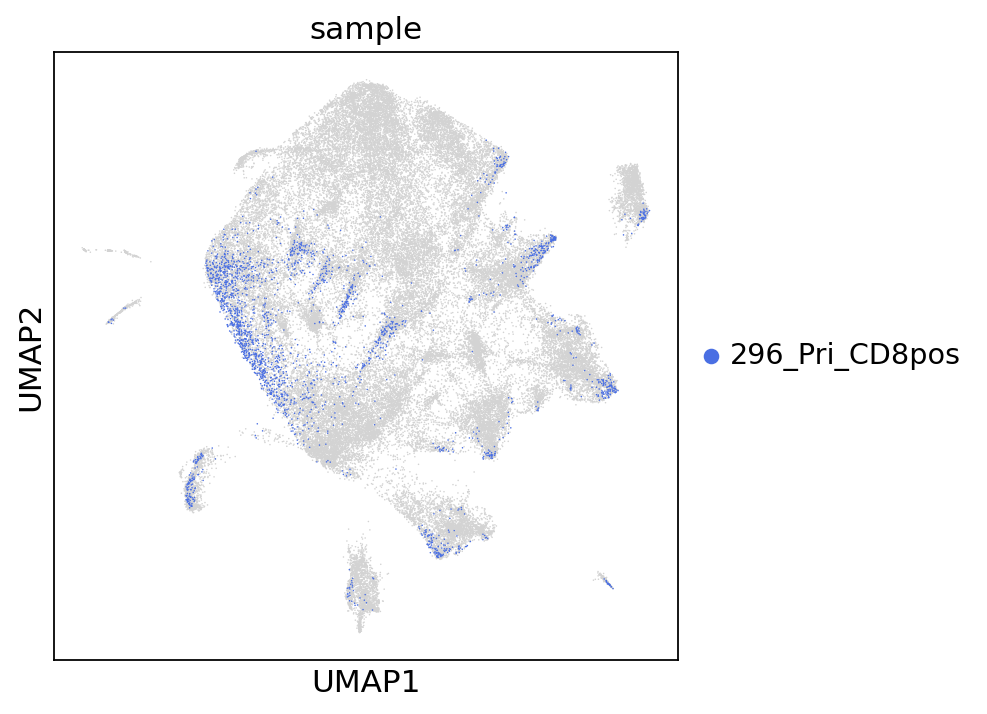

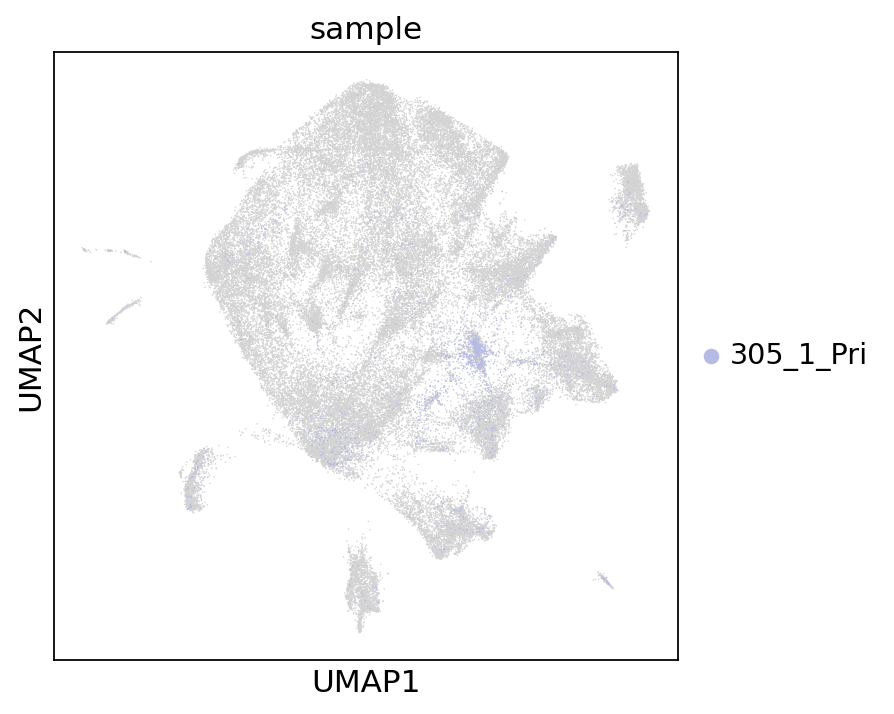

...

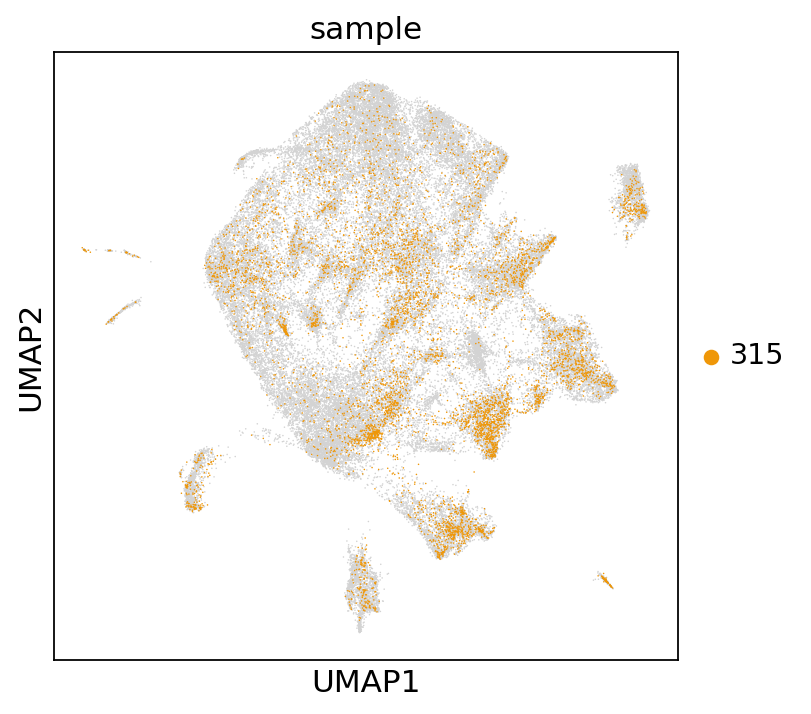

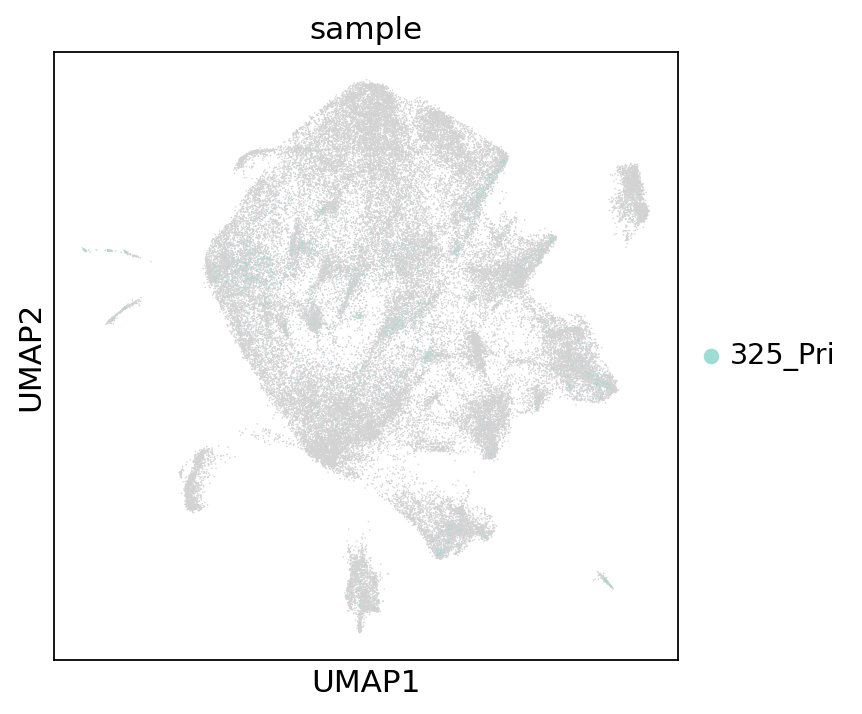

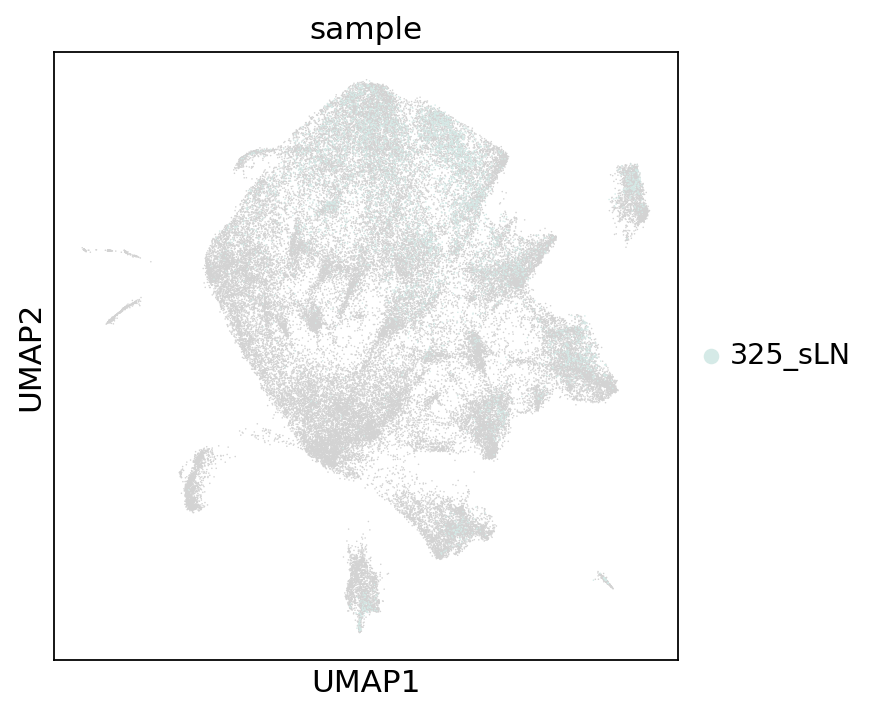

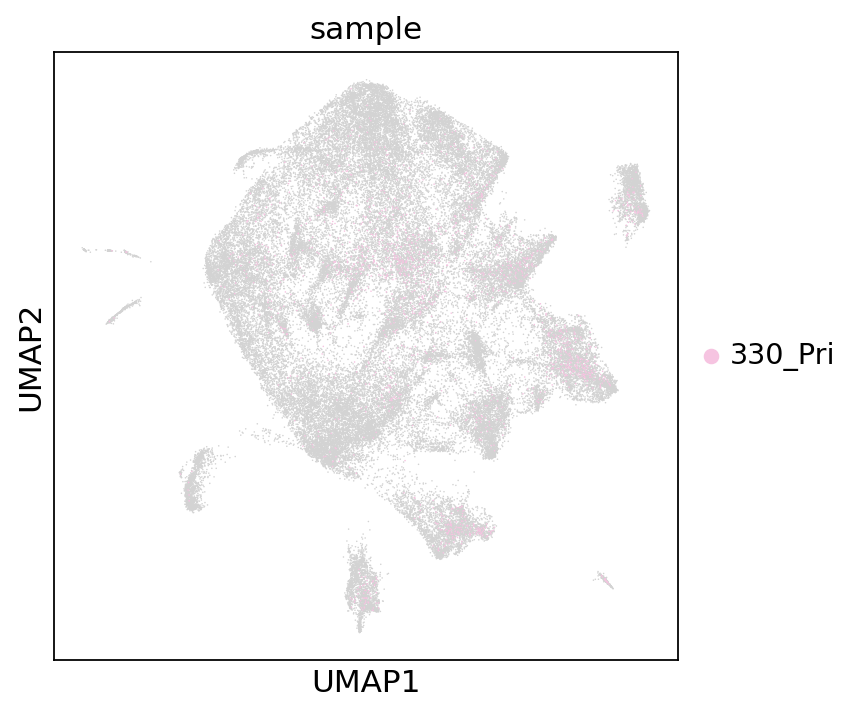

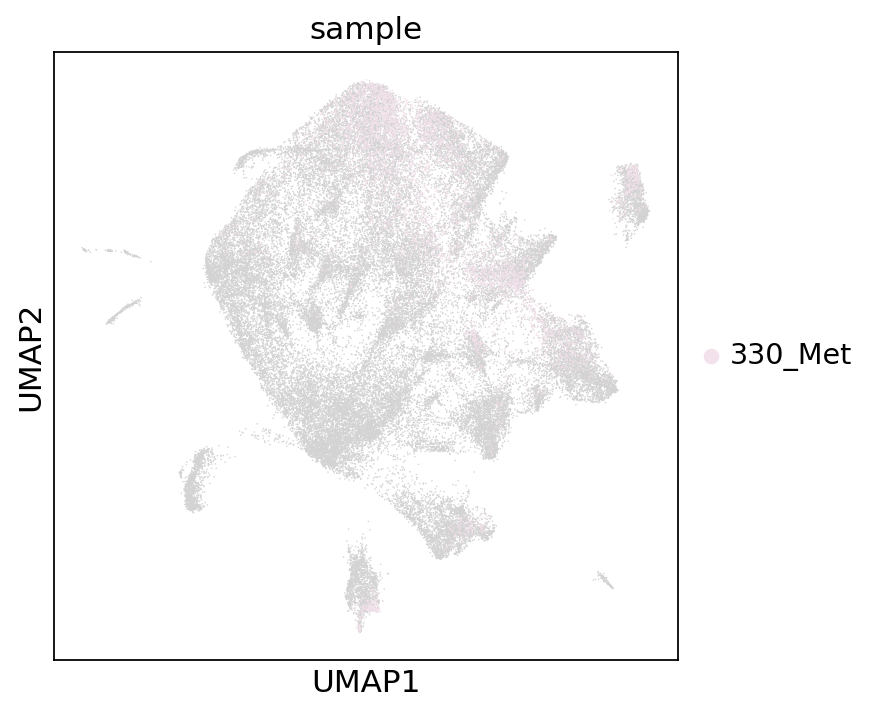

In [8]:
for sample in dataset_names:
    fig, ax = plt.subplots(figsize=(5,5))
    sc.pl.umap(batch_corrected_umap, color='sample', groups=[sample], ax=ax)
    ax.get_legend().remove()
    ax.set_title('Sample '+sample)
    plt.show()

## UMAP Visualization by Groups

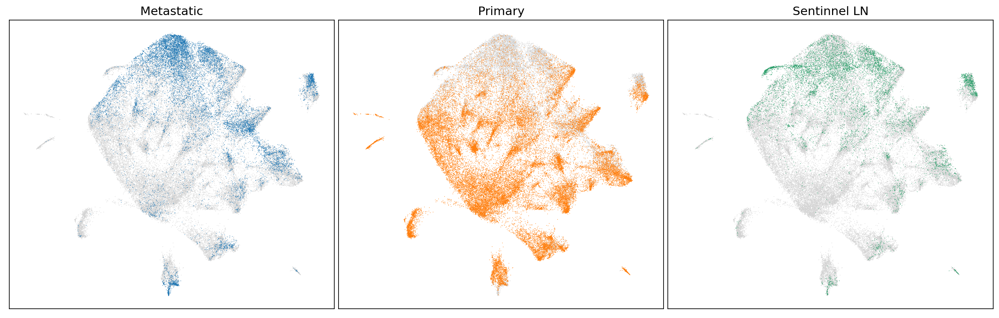

In [9]:
fig, ax = plt.subplots(1, 3,sharex=True,gridspec_kw={'width_ratios': [1, 1, 1]}, figsize=(16,5))
i=0
for g in set(batch_corrected_umap.obs['group']):
    sc.pl.umap(batch_corrected_umap, color='group',groups=[g],ax=ax[i],show=False)
    ax[i].get_legend().remove()
    ax[i].set_title(g)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
    
    i += 1

plt.tight_layout(pad=0.1)
plt.show()


## UMAP Visualization by Cell-cycles

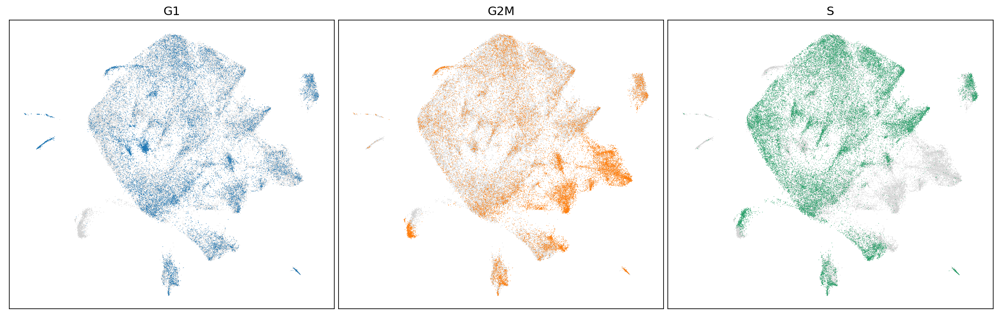

In [10]:
fig, ax = plt.subplots(1, 3,sharex=True,gridspec_kw={'width_ratios': [2, 2, 2]}, figsize=(16,5))
i = 0
for g in set(batch_corrected_umap.obs['phase']):
    sc.pl.umap(batch_corrected_umap, color='phase', groups=[g],ax=ax[i],show=False)
    ax[i].get_legend().remove()
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
    ax[i].set_title(g)
    i += 1
plt.tight_layout(pad=0.1)
plt.show()

## Expression of CD4, CD8, CD45, CD19 and CD56 

In [11]:
# plot based on count-normalized expression

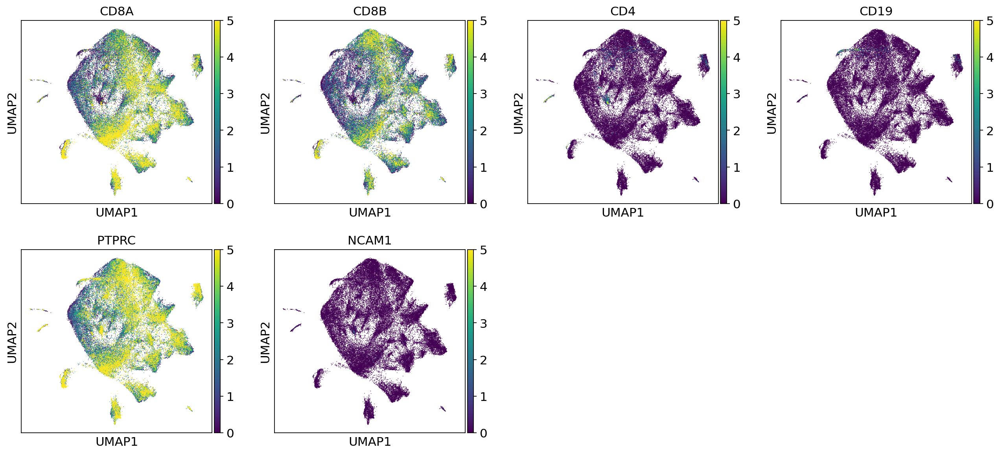

In [12]:
sc.pl.umap(batch_corrected_umap,color=['CD8A','CD8B','CD4','CD19','PTPRC','NCAM1'],use_raw=True,vmax=5)

## Expression of Exhaustion Markers

In [13]:
exhaustion_markers = ['CXCL13','CTLA4','PDCD1','HAVCR2','TIGIT','BTLA','CD244','CD160','ICOS','LAG3']

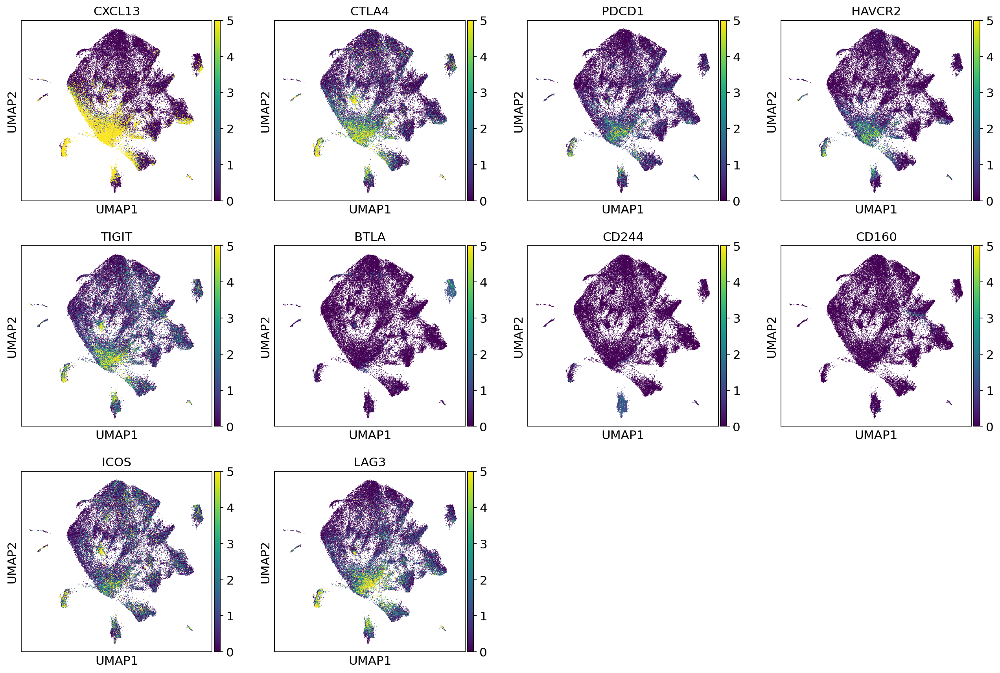

In [14]:
sc.pl.umap(batch_corrected_umap,color=exhaustion_markers,use_raw=True,vmax=5)

## Expression of Proliferation Markers

In [15]:
proliferation_markers = ['TOP2A','MKI67','TNFRSF9'] 

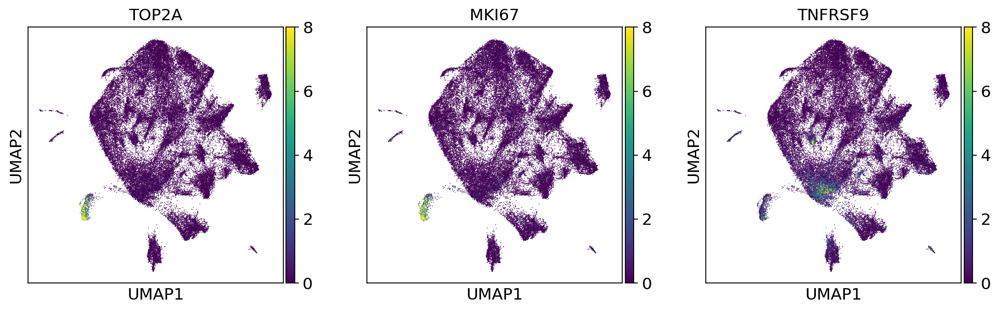

In [16]:
sc.pl.umap(batch_corrected_umap,color=proliferation_markers,vmax=8)

## HLA Genes

In [ ]:
HLA_genes = ['HLA-F','HLA-G','HLA-A','HLA-E','HLA-C','HLA-B','HLA-DRA','HLA-DRB5','HLA-DRB1','HLA-DQA1','HLA-DQB1',
             'HLA-DQB1-AS1','HLA-DQA2','HLA-DQB2','HLA-DOB','HLA-DMB','HLA-DMA','HLA-DOA','HLA-DPA1','HLA-DPB1']

In [ ]:
sc.pl.umap(batch_corrected_umap,color=HLA_genes,vmax=8)

## Expression of Extra Genes requested

In [17]:
extra_genes = ['XCL1','NKG7','CD2','CD3E','CD3G','CD3D','CD247','IGHG1','CD79A','CD163','CD68','CD14','FCGR3A','LAMP3','LILRA4',
               'TPSAB1','CCR7','SELL','IL7R','CD69','IL2RA','EOMES','TBX21','IFNG','FOXP3']

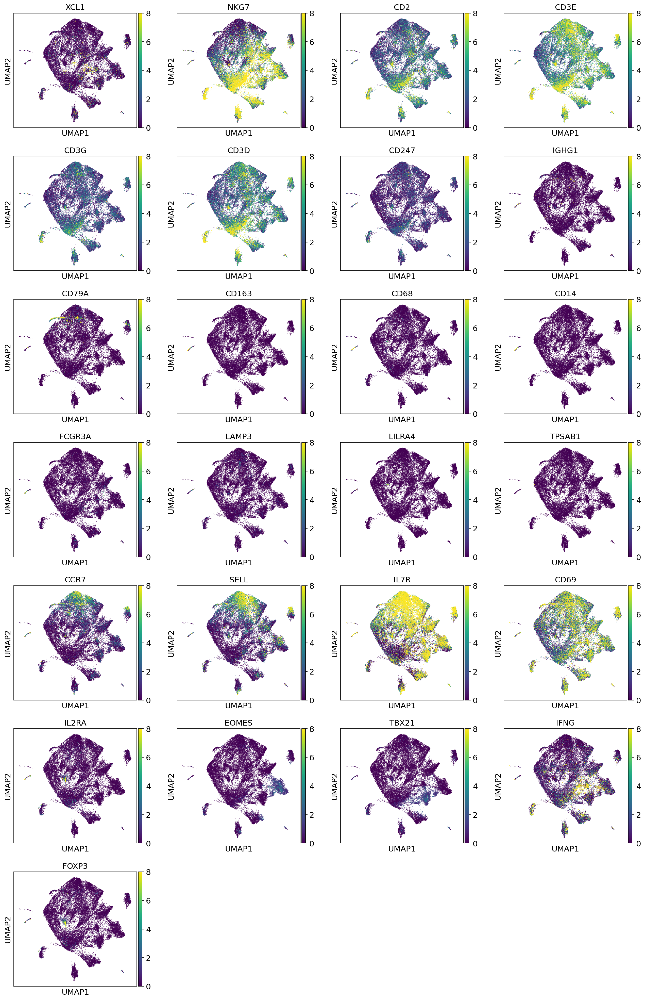

In [18]:
sc.pl.umap(batch_corrected_umap,color=extra_genes,vmax=8)

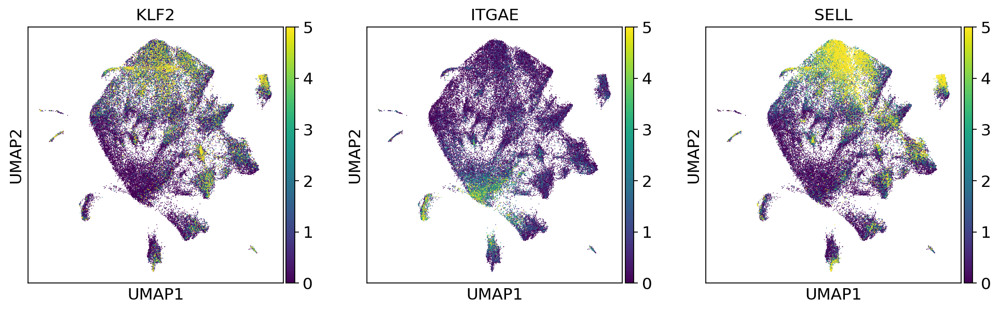

In [19]:
sc.pl.umap(batch_corrected_umap,color=['KLF2','ITGAE','SELL'],use_raw=True,vmax=5)

In [ ]:
fig, ax = plt.subplots(figsize=(15,15))
sc.pl.stacked_violin(batch_corrected_umap, HLA_genes, groupby='sample', dendrogram=True, ax=ax)